# Fantasy maps predictions

Process / work items:

  1. Get an exportable TF model.
  1. Generate C library (minimal) that calls into TF model
  1. Test C library with real files
  1. OSSPO process for library
  1. Release! 

# START HERE: Set up GCP environment

First we need to install all of our libraries--including the Vertex AI library--so that we can restart the kernel before doing anything else.

In [58]:
!pip install  --user jsonlines imgaug imageio pillow google-cloud-storage google-cloud-aiplatform==1.3.0 kfp google-cloud-pipeline-components google-cloud-firestore

In [75]:
! pip uninstall -y fantasy-maps

Found existing installation: fantasy-maps 0.1.0
Uninstalling fantasy-maps-0.1.0:
  Successfully uninstalled fantasy-maps-0.1.0


In [77]:
! pip install --upgrade ..

Processing /home/jupyter/FantasyMaps
  Preparing metadata (setup.py) ... done
  Created wheel for fantasy-maps: filename=fantasy_maps-0.1.0-py3-none-any.whl size=8487 sha256=d153a7b7f3a4af828fc19aef8d7c4e36602293a0fd38a0a8aa56c88966f15a92
  Stored in directory: /tmp/pip-ephem-wheel-cache-1vx4s39r/wheels/0b/82/e1/1ada250fdbcebff835c7af761a03d1def55d5cbbe7ed027c64
Successfully built fantasy-maps
  Attempting uninstall: fantasy-maps
    Found existing installation: fantasy-maps 0.1.0
    Uninstalling fantasy-maps-0.1.0:
      Successfully uninstalled fantasy-maps-0.1.0


Verify your library settings and Python version (for troubleshooting purposes).

In [53]:
! pip show google-cloud-aiplatform
! python --version

Name: google-cloud-aiplatform
Version: 1.3.0
Summary: Cloud AI Platform API client library
Home-page: https://github.com/googleapis/python-aiplatform
Author: Google LLC
Author-email: googleapis-packages@google.com
License: Apache 2.0
Location: /home/jupyter/.local/lib/python3.7/site-packages
Requires: google-api-core, google-cloud-bigquery, google-cloud-storage, packaging, proto-plus
Required-by: fantasy-maps, google-cloud-pipeline-components
Python 3.7.12


In [55]:
# Get your GCP project id from gcloud
shell_output=!gcloud config list --format 'value(core.project)' 2>/dev/null
PROJECT_ID=shell_output[0]
print("Project ID: ", PROJECT_ID)

from datetime import datetime

TIMESTAMP = datetime.now().strftime("%Y%m%d%H%M%S")

Project ID:  fantasymaps-334622


In [67]:
#@markdown Store the resource names for this experiment
display_name = f'dnd-maps-predictions-{TIMESTAMP}'  #@param {type: "string"}
LOCATION = 'us-central1' #@param {type: "string"}
model_id = '7292897899317297152' #@param {type: "string"}
endpoint_id = '5038516432330031104' #@param {type: "string"}
gcs_bucket_name = 'fantasy-maps' #@param {type: "string"}
collection_name = "FantasyMaps"

Authenticate the current logged in user. This allows you to use the Google Cloud Platform projects associated with your email address.

In [6]:
## COLAB ONLY! ##
try:
    from google.colab import auth
    auth.authenticate_user()
except:
    print('Not running in Colab')

Not running in Colab


Set your current Google Cloud Project project ID with the `gcloud` tool (Google Cloud SDK). This helps when moving files to and from Cloud Storage buckets.

# Send prediction requests to model

With the URIs of the test files, we can test whether the model can predict where the top left cell is on the image.


**Important**: For online prediction, test files must be less than
1.5 MB in size. Realistically, this means ~1.2MB in size.

In [57]:
from google.cloud import aiplatform


try:
  print(f"Project is: {PROJECT_ID}")
except NameError:
  print("PROJECT_ID isn't set. Go back to 'START HERE'")

try:
  print(f"Location is: {LOCATION}")
except NameError:
  print("LOCATION isn't set. Go back to 'START HERE'")

aiplatform.init(project=PROJECT_ID, location=LOCATION)

Project is: fantasymaps-334622
Location is: us-central1


Before we can get predictions on these files, we first need to move them into a local directory and convert their data to base64 encoding.

In [60]:
from google.cloud import firestore
       
firestore_client = firestore.Client(project=PROJECT_ID)
collection_ref = firestore_client.collection(collection_name)

# Collect scraped data for predictions
test_files = []
scraped_docs = (collection_ref
            .where("source", "==", "ScrapedData")
            .select(["gcsURI", "computedBBoxes"])
            .stream())

for d in scraped_docs:
    doc_dict = d.to_dict()


    test_files.append(doc_dict["gcsURI"])

In [61]:
import base64
import os

SAMPLE_DATA_FOLDER = "sample_data/"

if not os.path.exists(SAMPLE_DATA_FOLDER):
    os.mkdir(SAMPLE_DATA_FOLDER)

for gcs_sample_file in test_files:
    print(gcs_sample_file)
    ! gsutil cp $gcs_sample_file $SAMPLE_DATA_FOLDER

gs://fantasy-maps/ScrapedData/volcanic_outcrop_[30x30][2100x.jpg
CommandException: No URLs matched: gs://fantasy-maps/ScrapedData/volcanic_outcrop_[30x30][2100x.jpg
gs://fantasy-maps/ScrapedData/tower_in_the_feywild_[battlema.jpg
Copying gs://fantasy-maps/ScrapedData/tower_in_the_feywild_[battlema.jpg...
/ [1 files][499.4 KiB/499.4 KiB]                                                
Operation completed over 1 objects/499.4 KiB.                                    
gs://fantasy-maps/ScrapedData/the_boiling_point_alchemy_sho.jpg
Copying gs://fantasy-maps/ScrapedData/the_boiling_point_alchemy_sho.jpg...
/ [1 files][  3.3 MiB/  3.3 MiB]                                                
Operation completed over 1 objects/3.3 MiB.                                      
gs://fantasy-maps/ScrapedData/shipwreck_city_–_beach_party_e.jpg
Copying gs://fantasy-maps/ScrapedData/shipwreck_city_–_beach_party_e.jpg...
/ [1 files][  3.0 MiB/  3.0 MiB]                                                
Operati

In [62]:
local_test_files = []

for root, dirs, files in os.walk(SAMPLE_DATA_FOLDER):
    if len(files) > 0:
        for f in files:
            local_test_files.append(f"{SAMPLE_DATA_FOLDER}{f}")

print(local_test_files)

file_contents = []
for local_file in local_test_files:
    with open(local_file, "rb") as f:
        file_content = f.read()
    
    encoded_content = base64.b64encode(file_content).decode("utf-8")
    file_contents.append(encoded_content)
    

print(file_contents[0])
encoded_content = file_contents[0]
encoded_content2 = file_contents[1]
encoded_content3 = file_contents[2]

['sample_data/overgrown_catacomb_dungeon_[31.jpg', 'sample_data/petrified_battle_in_the_street.jpg', 'sample_data/small-cemetary.jpg', 'sample_data/desert.jpg', 'sample_data/lost_archives_of_the_marshland.jpg', 'sample_data/the_boiling_point_alchemy_sho.jpg', 'sample_data/40x40_at_the_edge_of_the_fey_w.jpg', 'sample_data/ruined-keep.jpg', 'sample_data/the_dungeon_of_dreaming_books_.jpg', 'sample_data/if_a_spontaneous_court_battle_.jpg', 'sample_data/floating_dragon_hatchery_battl.jpg', 'sample_data/solar_geyser_ocean_variant_[27.jpg', 'sample_data/dark_fungal_hive_cavern_battle.jpg', 'sample_data/ruin_city_gates_-_red_desert_[.jpg', 'sample_data/treasure_cave_battle_map_30x30.jpg', 'sample_data/glowing_tropical_cave_-_60x60.jpg', 'sample_data/spider_infested_araneae_caves_.jpg', 'sample_data/the_weeping_meadow_-_haunted_s.jpg', 'sample_data/tower_in_the_feywild_[battlema.jpg', 'sample_data/inside_the_krayt_dragon_[40x25.jpg', 'sample_data/dinosaur_jungle_statues_[34x55.jpg', 'sample_da

In [63]:
print(encoded_content)

/9j/4gJkSUNDX1BST0ZJTEUAAQEAAAJUbGNtcwQwAABtbnRyUkdCIFhZWiAH5gAFAAIAEQAYACBhY3NwTVNGVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA9tYAAQAAAADTLWxjbXMAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAtkZXNjAAABCAAAAD5jcHJ0AAABSAAAAEx3dHB0AAABlAAAABRjaGFkAAABqAAAACxyWFlaAAAB1AAAABRiWFlaAAAB6AAAABRnWFlaAAAB/AAAABRyVFJDAAACEAAAACBnVFJDAAACEAAAACBiVFJDAAACEAAAACBjaHJtAAACMAAAACRtbHVjAAAAAAAAAAEAAAAMZW5VUwAAACIAAAAcAHMAUgBHAEIAIABJAEUAQwA2ADEAOQA2ADYALQAyAC4AMQAAbWx1YwAAAAAAAAABAAAADGVuVVMAAAAwAAAAHABOAG8AIABjAG8AcAB5AHIAaQBnAGgAdAAsACAAdQBzAGUAIABmAHIAZQBlAGwAeVhZWiAAAAAAAAD21gABAAAAANMtc2YzMgAAAAAAAQxCAAAF3v//8yUAAAeTAAD9kP//+6H///2iAAAD3AAAwG5YWVogAAAAAAAAb6AAADj1AAADkFhZWiAAAAAAAAAknwAAD4QAALbDWFlaIAAAAAAAAGKXAAC3hwAAGNlwYXJhAAAAAAADAAAAAmZmAADypwAADVkAABPQAAAKW2Nocm0AAAAAAAMAAAAAo9cAAFR7AABMzQAAmZoAACZmAAAPXP/bAEMACAYGBwYFCAcHBwkJCAoMFA0MCwsMGRITDxQdGh8eHRocHCAkLicgIiwjHBwoNyksMDE0NDQfJzk9ODI8LjM0Mv/bAEMBCQkJDAsMGA0NGDIhHCEyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIy

## View the files to be analyzed

These are the files used for predictions:

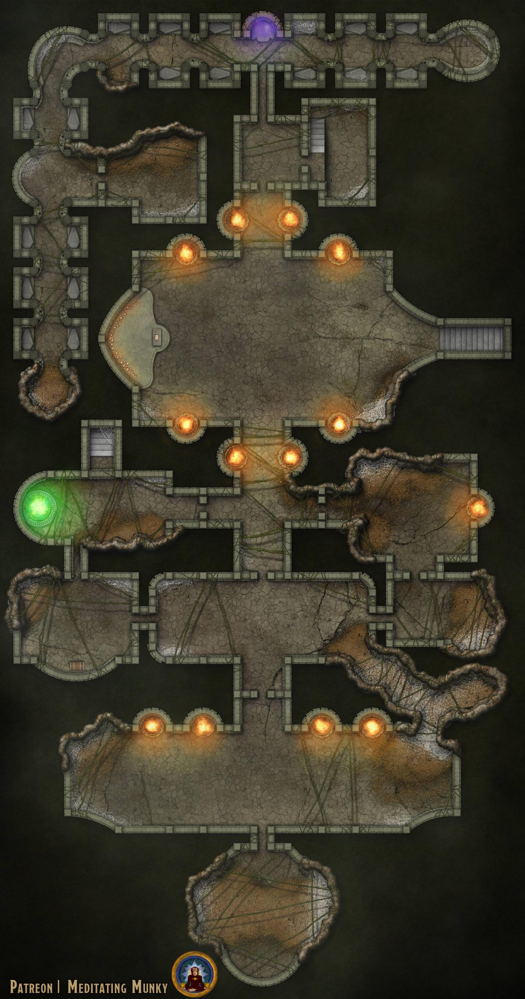

In [64]:
from IPython.display import Image
Image(filename=local_test_files[0]) 


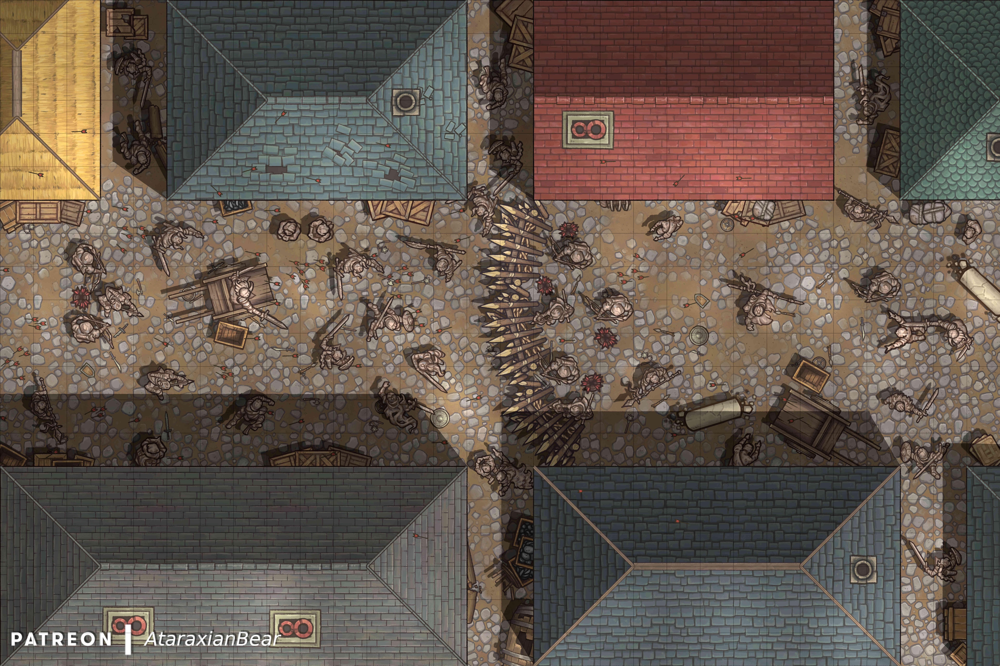

In [65]:
from IPython.display import Image
Image(filename=local_test_files[1]) 

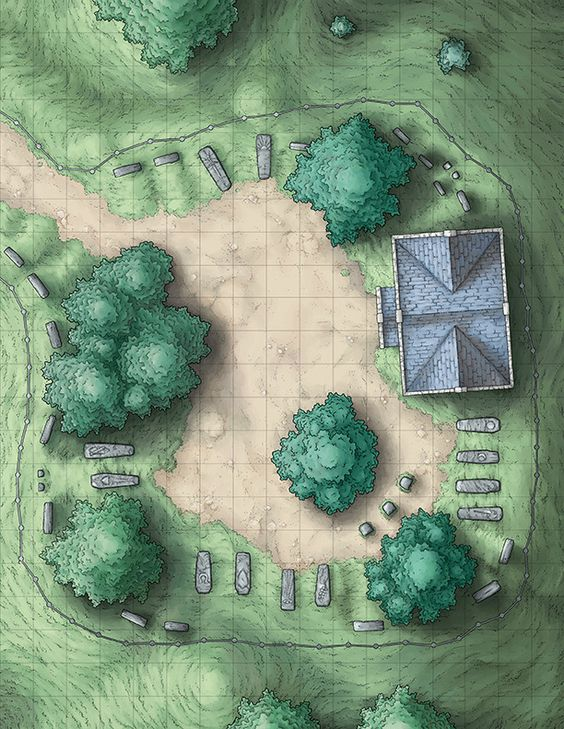

In [66]:
from IPython.display import Image
Image(filename=local_test_files[2]) 

## Get the predictions

In [68]:
from google.cloud import aiplatform

aiplatform.init(project=PROJECT_ID, location=LOCATION)

# Get the saved endpoint
try:
  endpoint_name = f"projects/{PROJECT_ID}/locations/{LOCATION}/endpoints/{endpoint_id}"
except NameError:
  print("endpoint_id isn't set. Go back to 'START HERE'")

endpoint = aiplatform.Endpoint(endpoint_name)

In [69]:
# Prediction for the first file
response = endpoint.predict(instances=[{"content": encoded_content, "mimeType": "image/jpeg"}],
                            parameters={
                                "confidence_threshold": 0.5,
                                "max_predictions": 5
                            })

In [70]:
response2 = endpoint.predict(instances=[{"content": encoded_content2, "mimeType": "image/jpeg"}],
                            parameters={
                                "confidence_threshold": 0.5,
                                "max_predictions": 5
                            })

FailedPrecondition: 400 The request size (3309724 bytes) exceeds 1.500MB limit.

In [71]:
response3 = endpoint.predict(instances=[{"content": encoded_content3, "mimeType": "image/png"}],
                            parameters={
                                "confidence_threshold": 0.5,
                                "max_predictions": 5
                            })

## Process the results

Each bounding box is an array of 4 numbers `xMin`, `xMax`, `yMin`, and `yMax`, which represent the extremal coordinates of the box. They are relative to the image size, and the point 0,0 is in the top left of the image.

Review the results for the first image.

In [72]:
print(response3.predictions[0])

{'bboxes': [[0.293089807, 0.353597075, 0.26718241, 0.314522982], [0.352562636, 0.414848953, 0.267137855, 0.315600485], [0.353386879, 0.411696494, 0.176790744, 0.22170493], [0.291622, 0.353321, 0.31414932, 0.362186611], [0.233390793, 0.294192016, 0.267352819, 0.314889967], [0.710700452, 0.769972503, 0.588352144, 0.63403374], [0.29372707, 0.352635592, 0.0850976855, 0.131037533], [0.35439533, 0.414988667, 0.315110505, 0.361464262], [0.354213029, 0.412538975, 0.910162032, 0.954215467], [0.473853678, 0.531968236, 0.178009212, 0.223633081], [0.295324236, 0.353062242, 0.68188417, 0.726801395], [0.356097668, 0.415285826, 0.634959817, 0.680898666], [0.293854415, 0.352864772, 0.909970105, 0.954614], [0.410966247, 0.475560933, 0.218272731, 0.269338161], [0.412908256, 0.472233832, 0.770799339, 0.817307413], [0.355933577, 0.414725304, 0.361885518, 0.407014161], [0.294230759, 0.354547679, 0.587588429, 0.633669257], [0.290122956, 0.347532064, 0.774476, 0.818299472], [0.351223648, 0.413936496, 0.13006

In [78]:
from fantasy_maps import process_predictions as fmpp
from typing import Union

predictions = response.predictions
bboxes, confidences, ids, display_names = fmpp.process_predictions(predictions)
print(confidences)

[0.347157866, 0.325404823, 0.320437193, 0.308722645, 0.305938214, 0.302532405, 0.299349934, 0.299331546, 0.298313707, 0.298160076, 0.296108037, 0.295031667, 0.294295073, 0.290849388, 0.288865805, 0.28749308, 0.286519378, 0.286278605, 0.285988271, 0.284710944, 0.284503818, 0.283836544, 0.283780158, 0.282797754, 0.280990183, 0.280628681, 0.279743224, 0.279293627, 0.27904591, 0.278553754, 0.276333332, 0.276251048, 0.276014686, 0.275608599, 0.275179833, 0.274610907, 0.273798198, 0.273171723, 0.272319764, 0.271749884, 0.271108061, 0.271025866, 0.270728201, 0.270169228, 0.270004064, 0.269907176, 0.268877506, 0.268386871, 0.267221242, 0.267137021, 0.266364843, 0.266356438, 0.266239107, 0.265837669, 0.265621156, 0.264999032, 0.264433622, 0.264394641, 0.262854725, 0.262646049, 0.262511164, 0.262313664, 0.261010647, 0.260507137, 0.259579808, 0.258640826, 0.25821051, 0.257897854, 0.257654905, 0.25607428, 0.255731076, 0.255715936, 0.254652649, 0.254651546, 0.253835768, 0.253366768, 0.252598, 0.251

Review the results for the second image.

In [36]:
predictions2 = response2.predictions
bboxes, confidences, ids, display_names = fmpp.process_predictions(predictions2)
print(confidences)

NameError: name 'fmpp' is not defined

Review the results for the third image.

In [79]:
predictions3 = response3.predictions
bboxes, confidences, ids, display_names = fmpp.process_predictions(predictions3)
print(confidences)

[0.855585873, 0.853443444, 0.843953133, 0.828136086, 0.820695519, 0.805871546, 0.803730547, 0.801108539, 0.796780765, 0.791358352, 0.790133655, 0.789978802, 0.788812459, 0.786697805, 0.784492493, 0.781889439, 0.781345367, 0.777788222, 0.777178645, 0.775237441, 0.772004306, 0.77179563, 0.770040095, 0.769845128, 0.768816888, 0.767880201, 0.765936494, 0.765475869, 0.763455, 0.761732101, 0.760835111, 0.757976949, 0.754945397, 0.754404664, 0.752453685, 0.749040365, 0.748339891, 0.747665524, 0.746575177, 0.745951772, 0.745200038, 0.744651139, 0.741809368, 0.741575122, 0.741060376, 0.738934875, 0.73856622, 0.730619669, 0.729967773, 0.729295433, 0.727970243, 0.724286497, 0.722766876, 0.720660388, 0.719631433, 0.71894151, 0.717722356, 0.717414677, 0.715116084, 0.712267578, 0.710090876, 0.709574938, 0.706800103, 0.703365088, 0.702793837, 0.702564955, 0.702332914, 0.699942291, 0.699684143, 0.695050895, 0.692868888, 0.692612886, 0.692451596, 0.692130685, 0.689213753, 0.687016785, 0.686761498, 0.68

## Show the results with ProcessedGridImage

In [80]:
from fantasy_maps import processed_grid_image

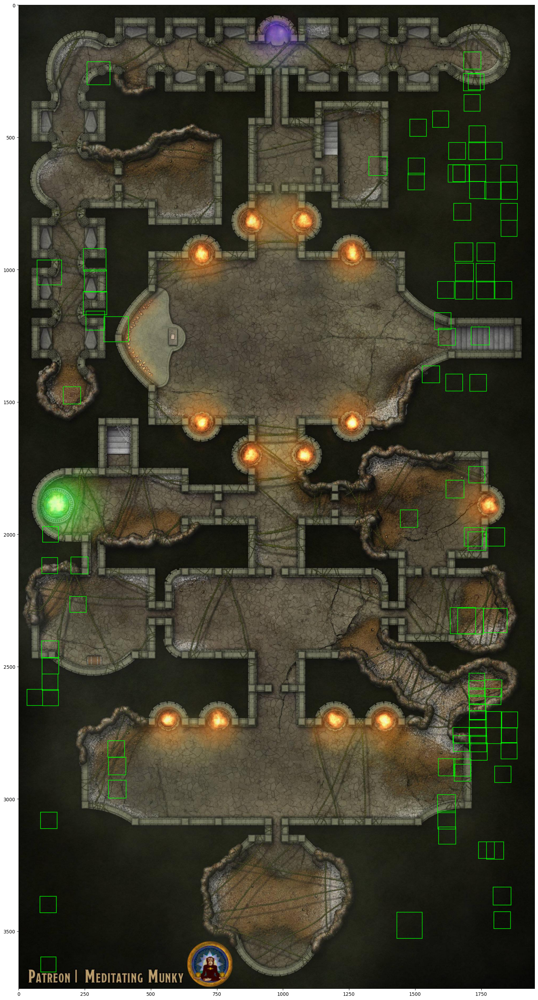

In [82]:
online_processed_image = processed_grid_image.analyze_annotation_results({"prediction": predictions[0]},
                                             local_file_uri=local_test_files[0])
online_processed_image.show()

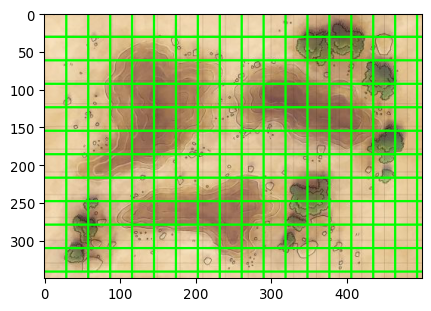

{"imageWidth": 500, "imageHeight": 350, "cellOffsetX": 0, "cellOffsetY": 0, "cellWidth": 31, "cellHeight": 32, "path": "sample_data/gridded-desert-ground.jpg"}


In [23]:
online_processed_image.show_normalized_results(is_grid_based=True)
print(online_processed_image)

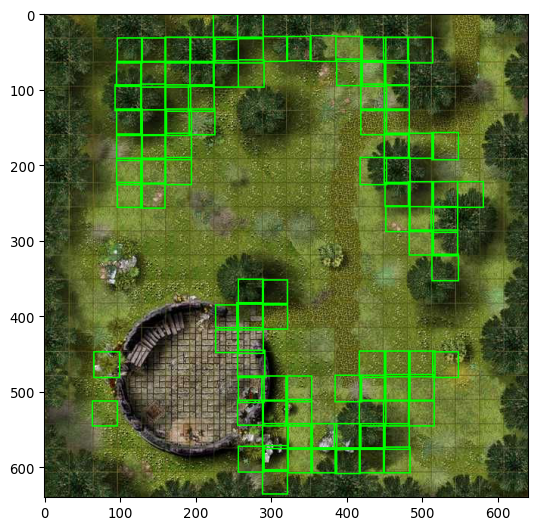

In [24]:
online_processed_image_2 = processed_grid_image.analyze_annotation_results({"prediction": predictions2[0]},
                                             local_file_uri=TEST_MAP_FILE_2)
online_processed_image_2.show()

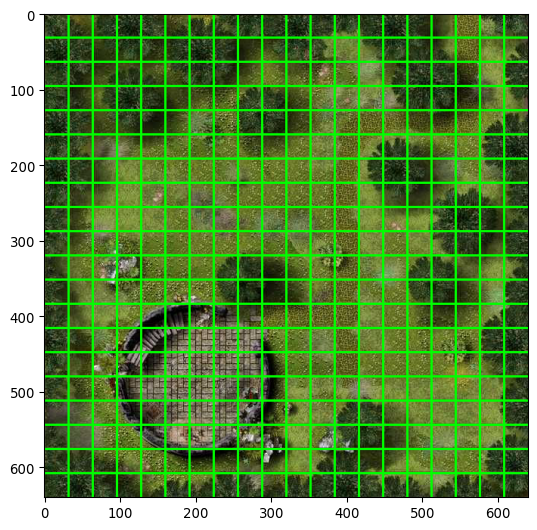

{"imageWidth": 640, "imageHeight": 640, "cellOffsetX": 0, "cellOffsetY": 0, "cellWidth": 33, "cellHeight": 33, "path": "sample_data/gridded-ruined-keep.jpg"}


In [25]:
online_processed_image_2.show_normalized_results(is_grid_based=True)
print(online_processed_image_2)

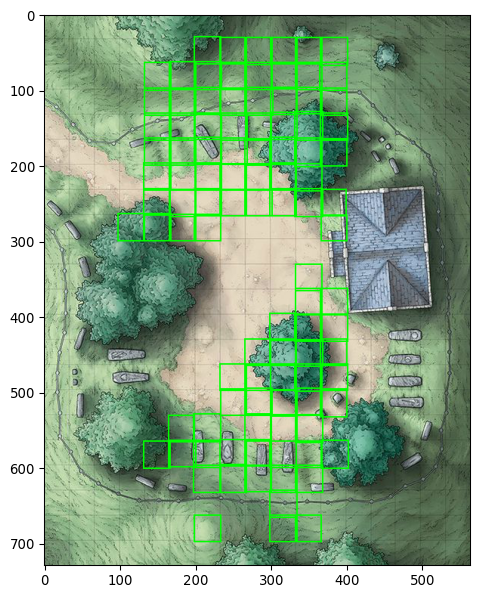

In [26]:
online_processed_image_3 = processed_grid_image.analyze_annotation_results({"prediction": predictions3[0]},
                                             local_file_uri=TEST_MAP_FILE_3)
online_processed_image_3.show()

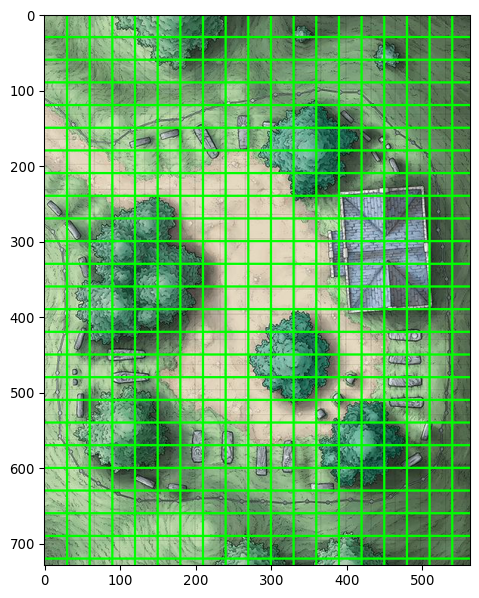

{"imageWidth": 564, "imageHeight": 729, "cellOffsetX": 0, "cellOffsetY": 0, "cellWidth": 35, "cellHeight": 35, "path": "sample_data/small-cemetary.jpg"}


In [27]:
online_processed_image_3.show_normalized_results()
print(online_processed_image_3)

## Store prediction results in GCS

In [28]:
from datetime import datetime

TIMESTAMP = datetime.now().strftime("%Y%m%d%H%M%S")

gcs_prefix = f'fantasy-maps-tests/manual-test-{TIMESTAMP}'

In [29]:
online_processed_image.store_image_as_dataset_row(gcs_bucket_name, gcs_prefix)

In [30]:
online_processed_image_2.store_image_as_dataset_row(gcs_bucket_name, gcs_prefix)

In [31]:
online_processed_image_3.store_image_as_dataset_row(gcs_bucket_name, gcs_prefix)

# Create batch prediction job and update dataset

In this step, we will use batch prediction jobs to bootstrap the retraining of models:

+ We will create a batch prediction job using the MVP IOD model. The batch prediction job will identify cells in a series of maps contained in a GCS bucket.
+ Once the job is completed, the results of prediction will be analyzed to identify cell coordinates (and create new training data).
+ The analyzed files will be moved into the dataset GCS folder and its data will be included in the training data.

## Create the batch prediction job

First import and initialize the library.

In [43]:
# Get your GCP project id from gcloud
shell_output=!gcloud config list --format 'value(core.project)' 2>/dev/null
PROJECT_ID=shell_output[0]
print("Project ID: ", PROJECT_ID)
gcs_bucket = "fantasy-maps"
gcs_output_folder = "BatchPredictionOutput"
gcs_batch_prediction_output = f"gs://{gcs_bucket}/{gcs_output_folder}"

Project ID:  fantasymaps-334622


In [48]:
import os

from google.cloud import aiplatform as aip
from google.cloud import storage

aip.init(project=PROJECT_ID, location="us-central1")
storage_client = storage.Client(project=PROJECT_ID)

input_file_uri = "gs://fantasy-maps/ScrapedData/bp_input_20220508195542.jsonl"
model_id = "7292897899317297152"

Next create the batch prediction input file. We can use [this notebook](https://github.com/GoogleCloudPlatform/ai-platform-samples/blob/master/ai-platform-unified/notebooks/official/automl/automl-text-classification.ipynb) and [this documentation]() as a reference point.

Each line of the JSONL file for batch input should look like this:

```
{
  "content": "URI",
  "mimeType": "mime type"
}
```


Now that the input file is written, we can compose the batch prediction request.

In [49]:
from google.cloud.aiplatform import jobs
from datetime import datetime

TIMESTAMP = datetime.now().strftime("%Y%m%d%H%M%S")

job_display_name = f"maps-batch-predict-{TIMESTAMP}"
model = aip.Model(model_name=f"projects/{PROJECT_ID}/locations/us-central1/models/{model_id}")

batch_prediction_job = model.batch_predict(
    job_display_name=job_display_name,
    gcs_source=input_file_uri,
    gcs_destination_prefix=gcs_batch_prediction_output,
    sync=False, # This allows us to continue coding while the batch job processes
)

#batch_prediction_job_name = batch_prediction_job.resource_name

INFO:google.cloud.aiplatform.jobs:Creating BatchPredictionJob
INFO:google.cloud.aiplatform.jobs:BatchPredictionJob created. Resource name: projects/733537716875/locations/us-central1/batchPredictionJobs/7530002634044866560
INFO:google.cloud.aiplatform.jobs:To use this BatchPredictionJob in another session:
INFO:google.cloud.aiplatform.jobs:bpj = aiplatform.BatchPredictionJob('projects/733537716875/locations/us-central1/batchPredictionJobs/7530002634044866560')
INFO:google.cloud.aiplatform.jobs:View Batch Prediction Job:
https://console.cloud.google.com/ai/platform/locations/us-central1/batch-predictions/7530002634044866560?project=733537716875
INFO:google.cloud.aiplatform.jobs:BatchPredictionJob projects/733537716875/locations/us-central1/batchPredictionJobs/7530002634044866560 current state:
JobState.JOB_STATE_PENDING
INFO:google.cloud.aiplatform.jobs:BatchPredictionJob projects/733537716875/locations/us-central1/batchPredictionJobs/7530002634044866560 current state:
JobState.JOB_STAT

## Analyze the results

Once the batch prediction has finished, we will read the results as with online prediction and overlay the cells on the maps.

In [83]:
BUCKET_OUTPUT = gcs_batch_prediction_output

# Check that the results are in the bucket
! gsutil ls -a $BUCKET_OUTPUT

gs://fantasy-maps/BatchPredictionOutput/#1639674763527555
gs://fantasy-maps/BatchPredictionOutput/prediction-dnd-maps-full-grid-model-online-20220401222633-2022-05-09T17:02:25.930548Z/


Copy the batch prediction results locally.

In [84]:
import os

RESULTS_DIRECTORY = "prediction_results"
RESULTS_DIRECTORY_FULL = f"{RESULTS_DIRECTORY}/output"

# Create missing directories
os.makedirs(RESULTS_DIRECTORY, exist_ok=True)

# Get the Cloud Storage paths for each result
! gsutil -m cp -r $BUCKET_OUTPUT $RESULTS_DIRECTORY

Copying gs://fantasy-maps/BatchPredictionOutput/prediction-dnd-maps-full-grid-model-online-20220401222633-2022-05-09T17:02:25.930548Z/predictions_00001.jsonl...


In [94]:
# Identify the directory that we want to use
latest_directory = "prediction_results/BatchPredictionOutput/prediction-dnd-maps-full-grid-model-online-20220401222633-2022-05-09T17:02:25.930548Z/"

Open the results file and read the results.

In [95]:
import jsonlines

# Get downloaded results in directory
results_files = []
for dirpath, subdirs, files in os.walk(latest_directory):
    for file in files:
        if file.find("predictions") >= 0:
            results_files.append(os.path.join(dirpath, file))


# Consolidate all the results into a list
results = []
result_data = []
for results_file in results_files:
    # Open each result
    with jsonlines.open(results_file) as reader:
        for result in reader.iter(type=dict, skip_invalid=True):
            result_data.append(result)
            instance = result["instance"]
            prediction = result["prediction"]
            print(f"\ninstance: {instance['content']}")
            for key, output in prediction.items():
                print(f"\n{key}: {output}")


instance: gs://fantasy-maps/ScrapedData/solar_geyser_ocean_variant_[27.jpg

ids: ['7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320

Download the first three files from the results.

In [98]:
downloaded_files = []
for result_to_download in result_data:
  downloaded_files.append(result_to_download)
  DOWNLOAD_URI = result_to_download['instance']['content']
  print(DOWNLOAD_URI)

  ! gsutil cp $DOWNLOAD_URI "prediction_results/output"


gs://fantasy-maps/ScrapedData/solar_geyser_ocean_variant_[27.jpg
Copying gs://fantasy-maps/ScrapedData/solar_geyser_ocean_variant_[27.jpg...
/ [1 files][  1.0 MiB/  1.0 MiB]                                                
Operation completed over 1 objects/1.0 MiB.                                      
gs://fantasy-maps/ScrapedData/the_boiling_point_alchemy_sho.jpg
Copying gs://fantasy-maps/ScrapedData/the_boiling_point_alchemy_sho.jpg...
/ [1 files][  3.3 MiB/  3.3 MiB]                                                
Operation completed over 1 objects/3.3 MiB.                                      
gs://fantasy-maps/ScrapedData/castle_siege_[60x30].jpg
CommandException: No URLs matched: gs://fantasy-maps/ScrapedData/castle_siege_[60x30].jpg
gs://fantasy-maps/ScrapedData/lost_archives_of_the_marshland.jpg
Copying gs://fantasy-maps/ScrapedData/lost_archives_of_the_marshland.jpg...
/ [1 files][  4.8 MiB/  4.8 MiB]                                                
Operation completed over 1 

Overlay the results on the downloaded files.

In [42]:
print(downloaded_files[0])

{'instance': {'content': 'gs://video-erschmid/DnD-batch-predict-input/forest-tracks.jpg', 'mimeType': 'image/jpeg'}, 'prediction': {'ids': ['1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '1050100674735374336', '10501006

In [ ]:
print(downloaded_files[0])

processed_image = processed_grid_image.analyze_annotation_results(downloaded_files[0], 
                                             local_file_uri="prediction_results/output/solar_geyser_ocean_variant_[27.jpg")
print(processed_image)
processed_image.show()

{'instance': {'content': 'gs://fantasy-maps/ScrapedData/solar_geyser_ocean_variant_[27.jpg', 'mimeType': 'image/jpeg'}, 'prediction': {'ids': ['7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '7001835730968248320', '70018

27 x 61


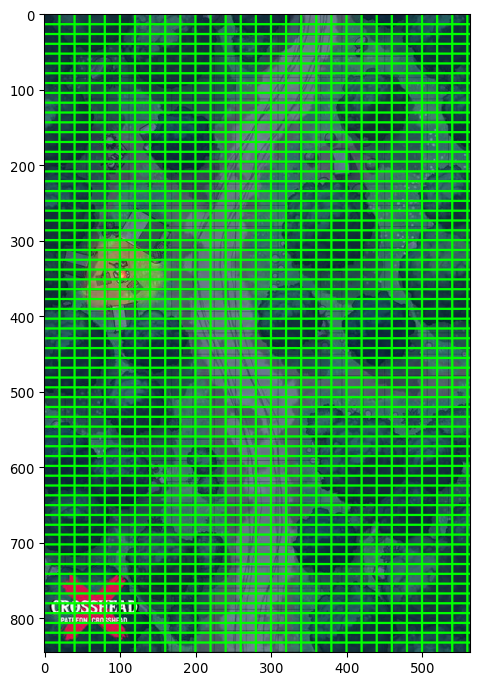

In [100]:
print(f"{processed_image.grid_cells_width} x {processed_image.grid_cells_height}")
processed_image.show_normalized_results(is_grid_based=True)

{"imageWidth": 1905, "imageHeight": 2857, "cellOffsetX": 0, "cellOffsetY": 0, "cellWidth": 100, "cellHeight": 100, "path": "prediction_results/output/forest-river-social-2.jpg"}


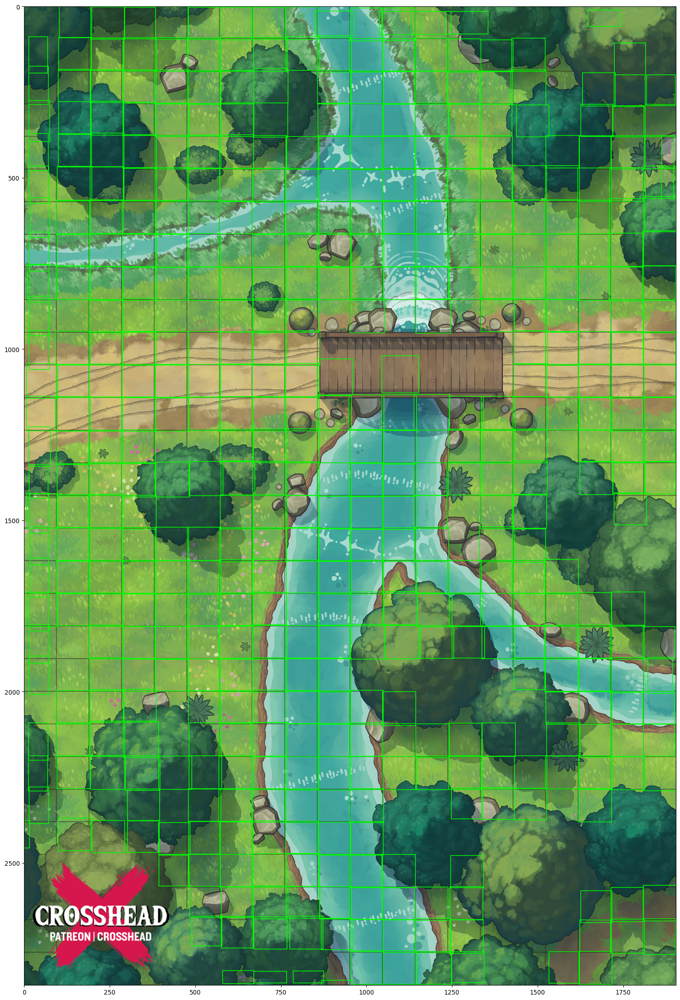

In [48]:
processed_image_2 = processed_grid_image.analyze_annotation_results(downloaded_files[1], 
                                             local_file_uri="prediction_results/output/forest-river-social-2.jpg")
print(processed_image_2)
processed_image_2.show()

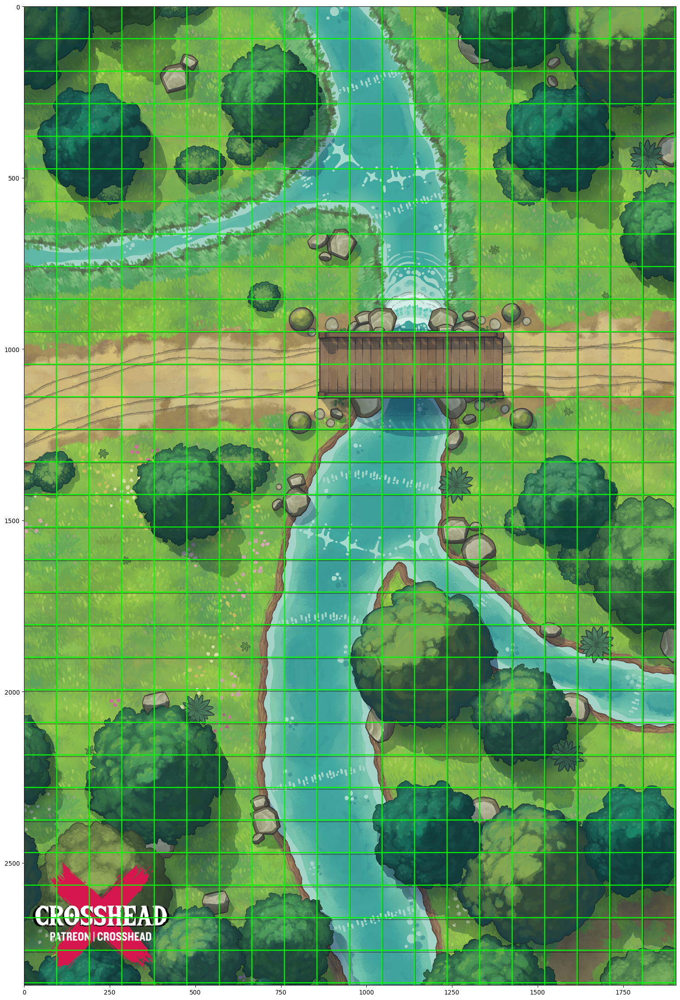

In [49]:
processed_image_2.show_normalized_results()

{"imageWidth": 2000, "imageHeight": 2000, "cellOffsetX": 0, "cellOffsetY": 0, "cellWidth": 105, "cellHeight": 104, "path": "prediction_results/output/GRIDDED-The-Potato-Thief-Lovers-social.jpg"}


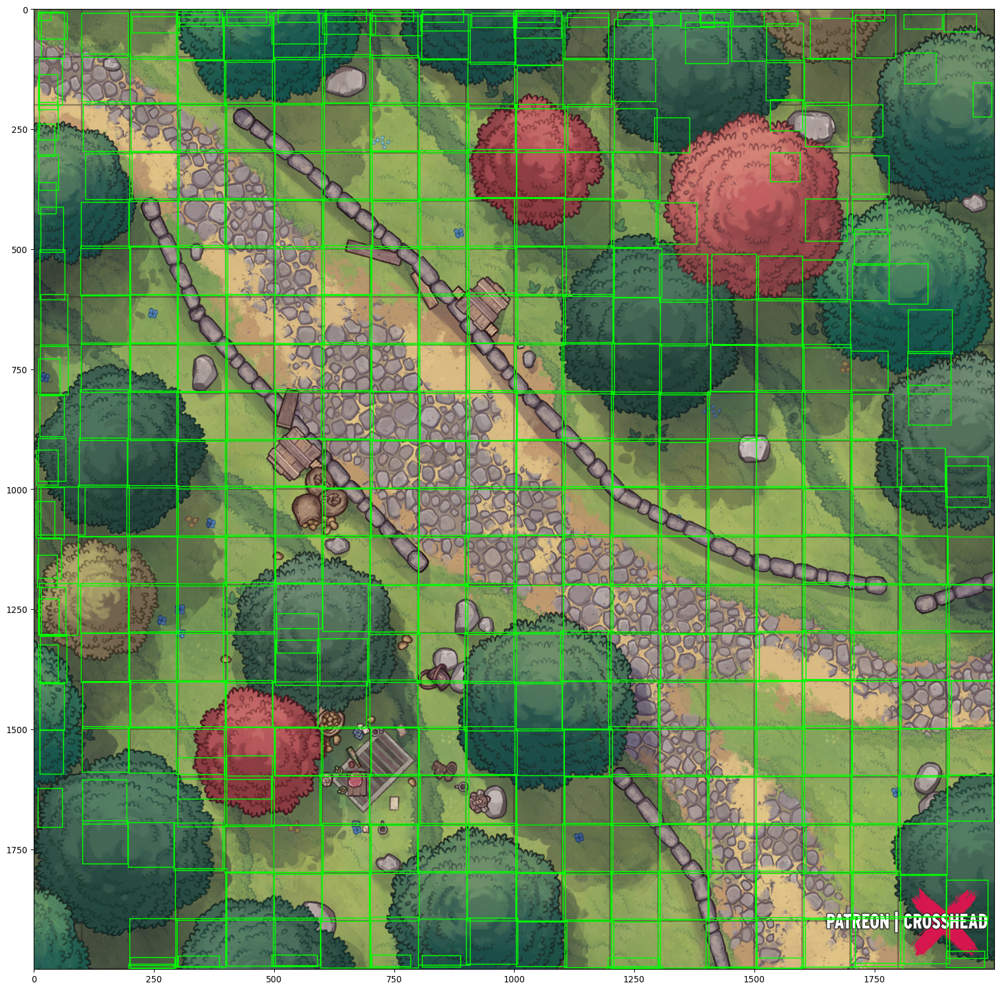

In [50]:
processed_image_3 = processed_grid_image.analyze_annotation_results(downloaded_files[2], 
                                             local_file_uri="prediction_results/output/GRIDDED-The-Potato-Thief-Lovers-social.jpg")
print(processed_image_3)
processed_image_3.show()

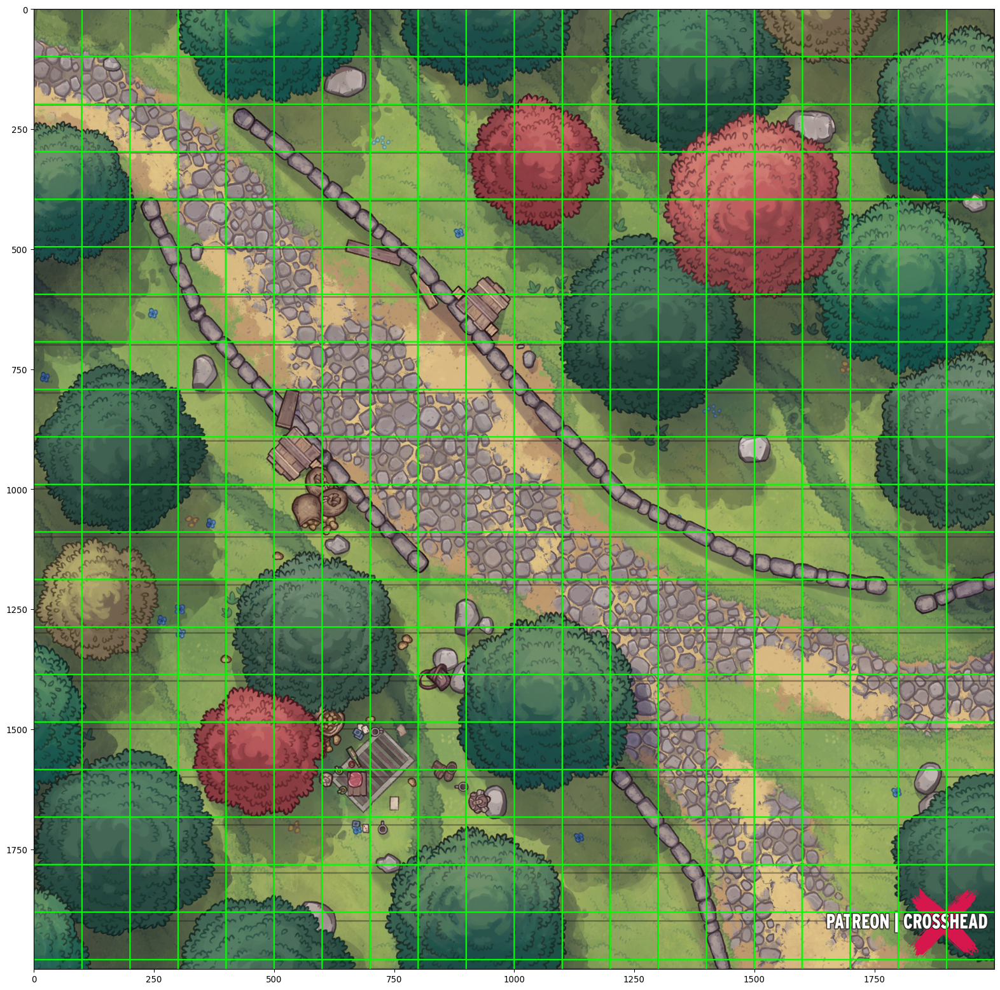

INFO:google.cloud.aiplatform.jobs:BatchPredictionJob projects/147301782967/locations/us-central1/batchPredictionJobs/8206809765301452800 current state:
JobState.JOB_STATE_RUNNING


In [51]:
processed_image_3.show_normalized_results()

{"imageWidth": 564, "imageHeight": 705, "cellOffsetX": 0, "cellOffsetY": 0, "cellWidth": 38, "cellHeight": 37, "path": "prediction_results/output/hard-landing.jpg"}


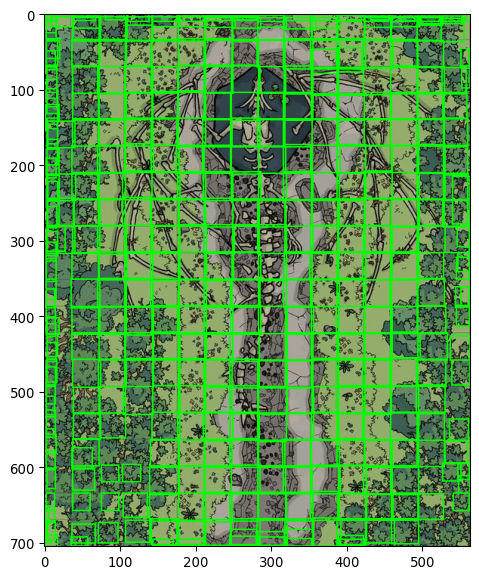

In [52]:
processed_image_4 = processed_grid_image.analyze_annotation_results(downloaded_files[3], 
                                             local_file_uri="prediction_results/output/hard-landing.jpg")
print(processed_image_4)
processed_image_4.show()

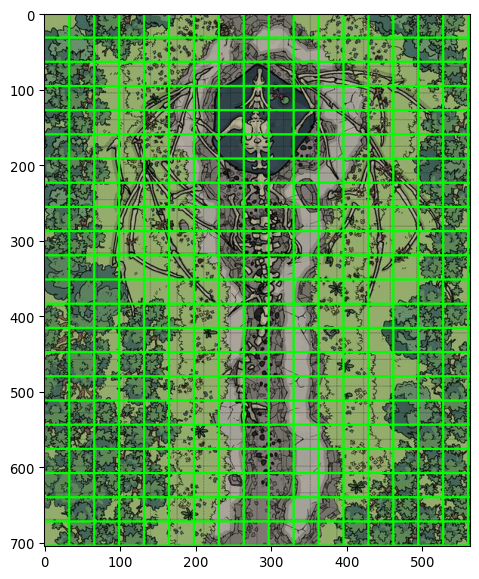

In [55]:
processed_image_4.show_normalized_results()

## Create new training data from the files from batch prediction

From these predictions, we need to output two different types of JSON objects:

1. A representation usable by D&D tools
2. A new training entry for a dataset




First step is to review all of the files from batch prediction.

In [56]:
print(f'1. {processed_image}\n2. {processed_image_2}\n3. {processed_image_3}\n4. {processed_image_4}')

1. {"imageWidth": 564, "imageHeight": 845, "cellOffsetX": 0, "cellOffsetY": 0, "cellWidth": 29, "cellHeight": 29, "path": "prediction_results/output/forest-tracks.jpg"}
2. {"imageWidth": 1905, "imageHeight": 2857, "cellOffsetX": 0, "cellOffsetY": 0, "cellWidth": 100, "cellHeight": 100, "path": "prediction_results/output/forest-river-social-2.jpg"}
3. {"imageWidth": 2000, "imageHeight": 2000, "cellOffsetX": 0, "cellOffsetY": 0, "cellWidth": 105, "cellHeight": 104, "path": "prediction_results/output/GRIDDED-The-Potato-Thief-Lovers-social.jpg"}
4. {"imageWidth": 564, "imageHeight": 705, "cellOffsetX": 0, "cellOffsetY": 0, "cellWidth": 38, "cellHeight": 37, "path": "prediction_results/output/hard-landing.jpg"}


In [57]:


gcs_prefix = f'fantasy-maps-tests/manual-batch-test-{TIMESTAMP}'

Second step is to upload the images to GCS with their training data.

In [58]:
processed_image.store_image_as_dataset_row(gcs_bucket_name, gcs_prefix)

In [59]:
processed_image_2.store_image_as_dataset_row(gcs_bucket_name, gcs_prefix)

In [60]:
processed_image_3.store_image_as_dataset_row(gcs_bucket_name, gcs_prefix)

In [61]:
processed_image_4.store_image_as_dataset_row(gcs_bucket_name, gcs_prefix)

INFO:google.cloud.aiplatform.jobs:BatchPredictionJob projects/147301782967/locations/us-central1/batchPredictionJobs/8206809765301452800 current state:
JobState.JOB_STATE_RUNNING
INFO:google.cloud.aiplatform.jobs:BatchPredictionJob projects/147301782967/locations/us-central1/batchPredictionJobs/8206809765301452800 current state:
JobState.JOB_STATE_RUNNING
INFO:google.cloud.aiplatform.jobs:BatchPredictionJob projects/147301782967/locations/us-central1/batchPredictionJobs/8206809765301452800 current state:
JobState.JOB_STATE_RUNNING
INFO:google.cloud.aiplatform.jobs:BatchPredictionJob projects/147301782967/locations/us-central1/batchPredictionJobs/8206809765301452800 current state:
JobState.JOB_STATE_SUCCEEDED
INFO:google.cloud.aiplatform.jobs:BatchPredictionJob run completed. Resource name: projects/147301782967/locations/us-central1/batchPredictionJobs/8206809765301452800
